# Исследование методов классификации движений человека

## Описание эксперимента

1. В первой части ноутбука проведено исследование нескольких моделей на распознавание ключевых точек на теле человека.  
Данные были взяты из датасета: .  
Описание моделей:  
  - BlazePose. Модель распознавания ключевых точек от проекта MediaPipe. Топология можели составляет 33 точки на теле человека. По сути она объединяет в себе топологию COCO (17 точек) и BlazeFace и BlazeHand. Итог работы представлен ниже.

2. Во второй части ноутбука мы исследовали некоторые модели на классификацию движений человека, исходя из их поз. Некоторые из моделей, представленных в данной части ноутбука, используют модели, которые были представлены ранее.  
Данные были взяты из двух датасетов: .  
Описание моделей:
  - Описания будут представлены позже.
  

In [1]:
!pip install tensorflow
!pip install mediapipe
!pip install -q opencv-python
!pip install -q git+https://github.com/tensorflow/docs
!python -m pip install pyyaml==5.1
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 462 kB 10.8 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 32.8 MB 177 kB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 274 kB 30.9 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=c9c567e56b3a765f235b696690560eaa6962338ea5651d647a667f9eafa4f50e
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/publ

In [2]:
# All imports
import cv2
import math
import numpy as np
from google.colab.patches import cv2_imshow

# Import matplotlib libraries
from matplotlib import pyplot as plt
from matplotlib.collections import LineCollection
import matplotlib.patches as patches

# sys utils
import os 
import shutil
import sys
import warnings

# First model
import mediapipe as mp

# Second model
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow_docs.vis import embed

# Next models will be load from git repositories and will be import there

## Первая чать работы: Pose Estimation

In [3]:
DESIRED_HEIGHT = 1080
DESIRED_WIDTH = 1080
def resize_and_show(image):
    h, w = image.shape[:2]
    if h < w:
        img = cv2.resize(image, (DESIRED_WIDTH, math.floor(h/(w/DESIRED_WIDTH))))
    else:
        img = cv2.resize(image, (math.floor(w/(h/DESIRED_HEIGHT)), DESIRED_HEIGHT))
    image = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(15, 15))
    plt.imshow(image)
    _ = plt.axis('off')

### Загрузка данных

In [ ]:
from google.colab import files, drive
# files.upload()
drive.mount('/content/drive')
%cp -av '/content/drive/MyDrive/Диплом/LSP/' '/content/data'
PATH = "/content/data/"

# можно загрузить данные на гугл диск и оттуда их подгружать в /content/
# Директория должны выглядеть:
# - /data
# |- data.txt
# |- joints.mat
# |- /images
#    |- 01.jpg
#    |- 02.jpg
#    ...

In [13]:
from scipy.io import loadmat
joints = loadmat(PATH + 'joints.mat')['joints']
joints

array([[[ 29.74645941,  28.12031897,  40.51695761, ..., 120.12745241,
          51.59369452,  44.42209685],
        [ 30.5501068 ,  49.17944312,  27.96569031, ..., 136.33061847,
          33.44243044,  42.59402151],
        [ 28.94281202,  62.60463477,  50.08729892, ..., 105.46744503,
          34.11469948,  42.59402151],
        ...,
        [ 53.85588112, 109.46118601,  93.54606195, ..., 119.54876791,
          29.4088162 ,  15.17289142],
        [ 38.184757  ,  81.0313684 ,  95.11497036, ..., 104.11718119,
          19.99704964,  32.08258831],
        [ 38.9884044 ,  83.40051987,  94.33051615, ...,  93.70086015,
          14.61889731,  40.30892734]],

       [[143.34544031, 166.65510177,  81.76862604, ..., 122.67616262,
         143.63021477, 174.13600322],
        [117.22690013, 136.64584985,  50.39045779, ...,  98.37141354,
         111.36130084, 138.4885341 ],
        [ 84.67918082,  95.84379681,  68.90357705, ..., 101.26483605,
          81.78146308, 105.58317799],
        ...,


In [14]:
real_data = []
for i in range(2000):
    photo = []
    for j in range(12):
        photo.append([joints[0,j,i], joints[1,j,i], joints[2,j,i]])
    real_data.append(photo)

real_data = np.array(real_data)

In [15]:
real_data

array([[[ 29.74645941, 143.34544031,   0.        ],
        [ 30.5501068 , 117.22690013,   0.        ],
        [ 28.94281202,  84.67918082,   0.        ],
        ...,
        [ 50.64129155,  44.09498761,   0.        ],
        [ 52.65041003,  58.96246433,   0.        ],
        [ 53.85588112,  58.96246433,   0.        ]],

       [[ 28.12031897, 166.65510177,   0.        ],
        [ 49.17944312, 136.64584985,   0.        ],
        [ 62.60463477,  95.84379681,   0.        ],
        ...,
        [ 98.66838488,  53.46230945,   0.        ],
        [111.30385937,  69.78313067,   0.        ],
        [109.46118601,  96.37027491,   0.        ]],

       [[ 40.51695761,  81.76862604,   0.        ],
        [ 27.96569031,  50.39045779,   0.        ],
        [ 50.08729892,  68.90357705,   0.        ],
        ...,
        [ 97.78211466,  66.55021444,   0.        ],
        [ 92.44782606,  98.08527352,   0.        ],
        [ 93.54606195,  96.35947427,   0.        ]],

       ...,

      

### Высчитывание метрик

In [5]:
# Right ankle
# Right knee
# Right hip
# Left hip
# Left knee
# Left ankle
# Right wrist
# Right elbow
# Right shoulder
# Left shoulder
# Left elbow
# Left wrist
# Neck
# Head top

KEYPOINTS = {
    "right ankle": 0,
    "right knee": 1,
    "right hip": 2,
    "left hip": 3,
    "left knee": 4,
    "left ankle": 5,
    "right wrist": 6,
    "right elbow": 7,
    "right shoulder": 8,
    "left shoulder": 9,
    "left elbow": 10,
    "left wrist": 11,
}

In [6]:
# Calculate metrics

def euclidian_metric(a, b):
    res = np.array(a) - np.array(b)
    return np.sqrt(np.sum(res ** 2))

def calc_diag(points):
    x_min = min(points[:, 0])
    x_max = max(points[:, 0])
    y_min = min(points[:, 1])
    y_max = max(points[:, 1])
    return euclidian_metric([x_min, y_min], [x_max, y_max])

def calc_height(points):
    y_min = min(points[:, 1])
    y_max = max(points[:, 1])
    return y_max - y_min

def calc_square(points):
    x_min = min(points[:, 0])
    x_max = max(points[:, 0])
    y_min = min(points[:, 1])
    y_max = max(points[:, 1])
    return (x_max - x_min) * (y_max - y_min)

def calc_pck(pred, real, threshold):
    height = calc_height(real)
    sum = 0
    for p, r in zip(pred, real):
        dist = euclidian_metric(p[:2], r[:2])
        if dist < threshold * height:
            sum += 1
    return sum / len(real)

def calc_pdj(pred, real, threshold):
    diag = calc_diag(real)
    sum = 0
    for p, r in zip(pred, real):
        dist = euclidian_metric(p[:2], r[:2])
        if dist < threshold * diag:
            sum += 1
    return sum / len(real)

def calc_oks(pred, real):
    square = calc_square(real)
    sum = 0
    for p, r in zip(pred, real):
        dist = euclidian_metric(p[:2], r[:2])
        sum += dist / square / k_i * int(r[2] > 0)
    
    return sum / np.sum(np.array(real)[:,2] > 0)

### Работа с Detectron2

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Mon_Oct_12_20:09:46_PDT_2020
Cuda compilation tools, release 11.1, V11.1.105
Build cuda_11.1.TC455_06.29190527_0
torch:  1.11 ; cuda:  cu113
detectron2: 0.6


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

model_final_f10217.pkl: 178MB [00:03, 48.6MB/s]                           
/usr/local/lib/python3.7/dist-packages/torch/functional.py:568: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2228.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


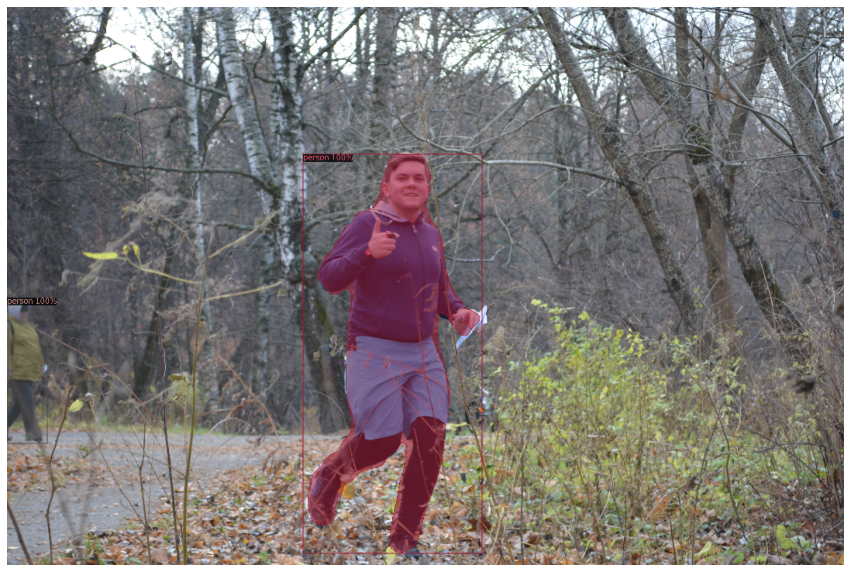

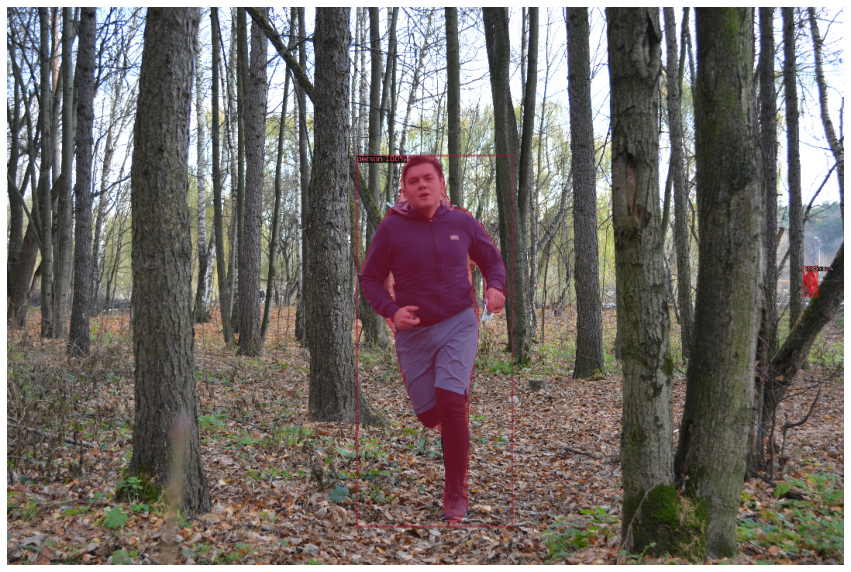

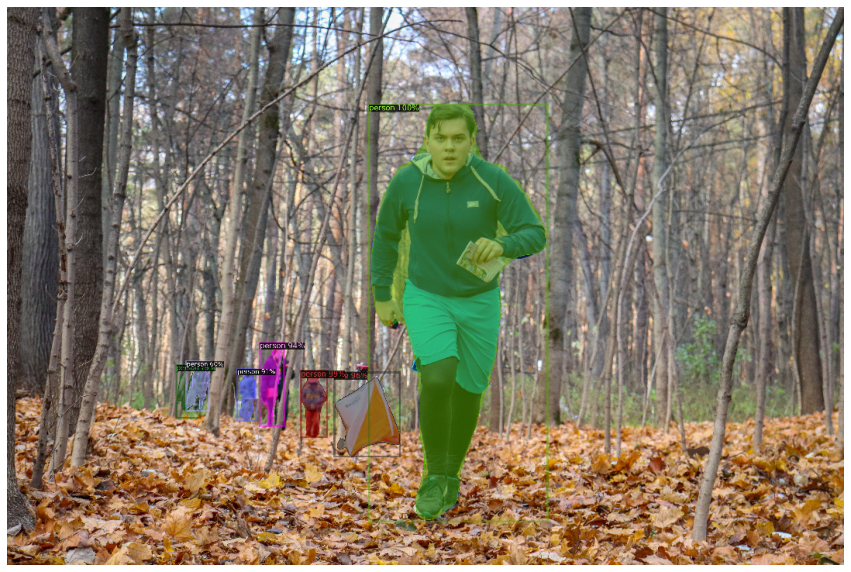

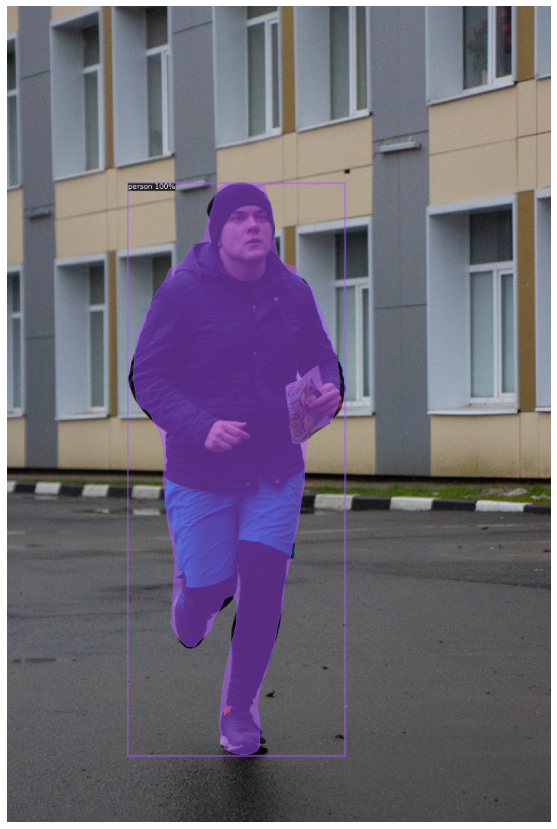

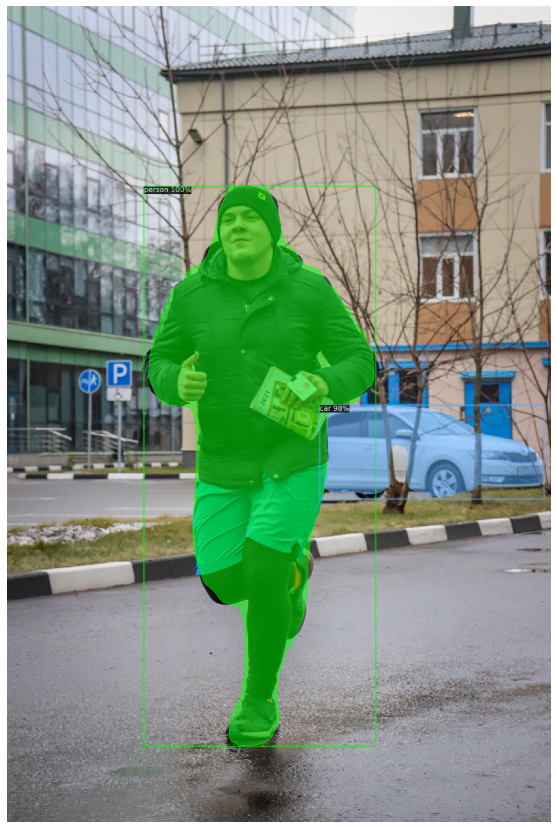

...

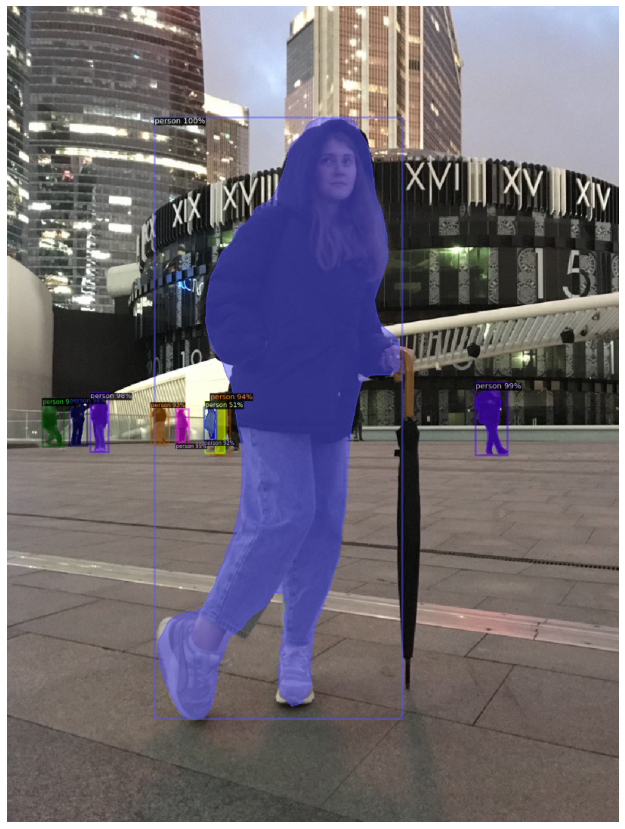

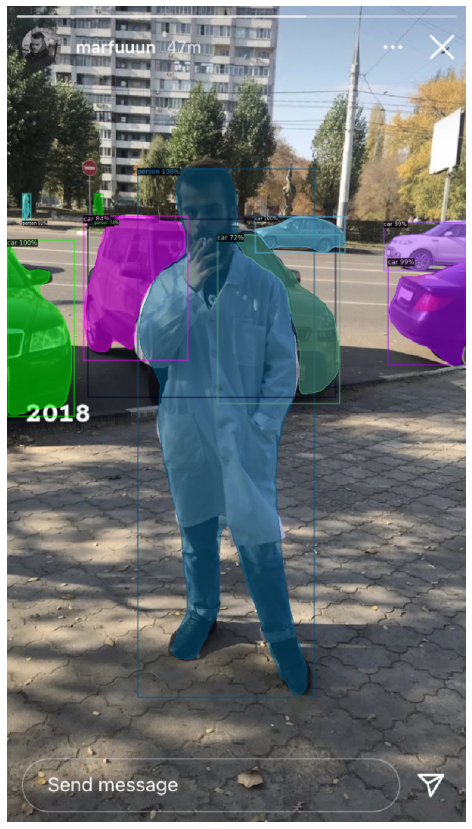

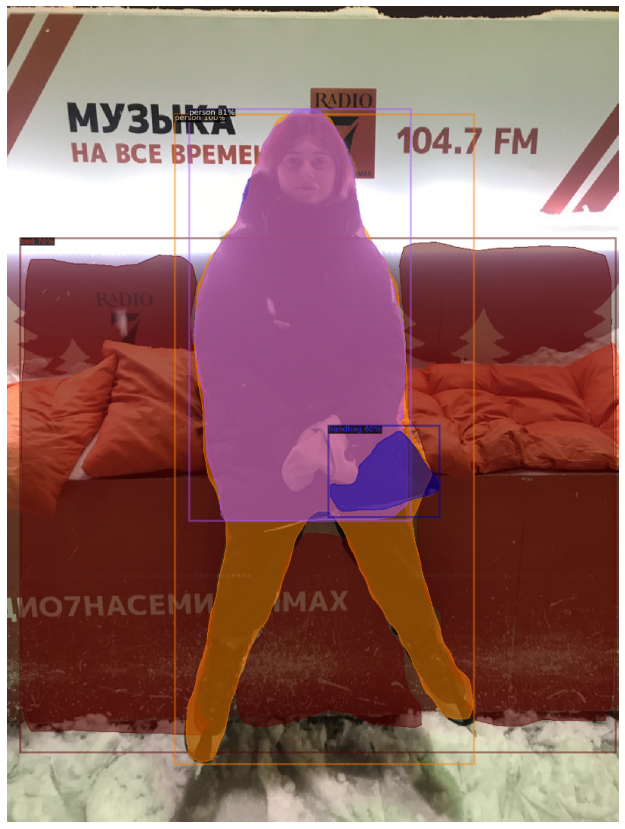

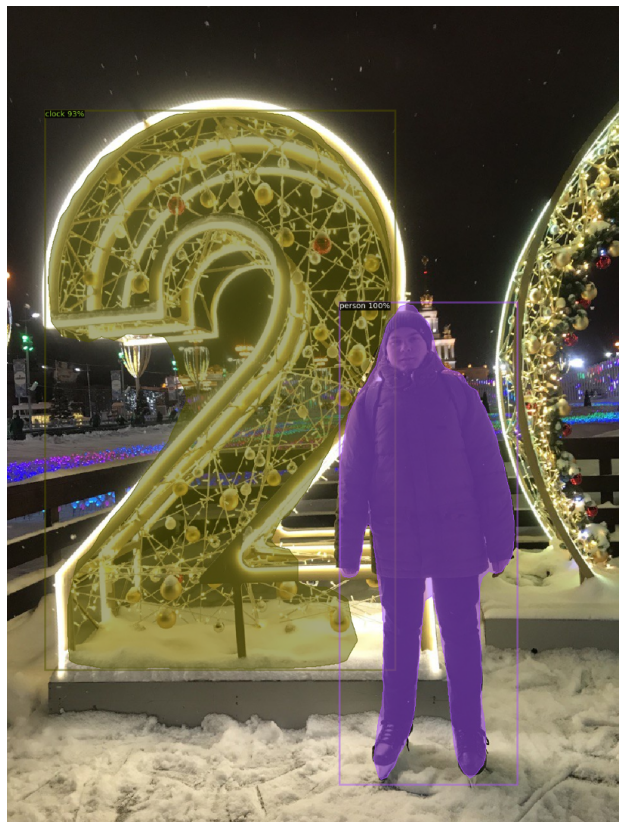

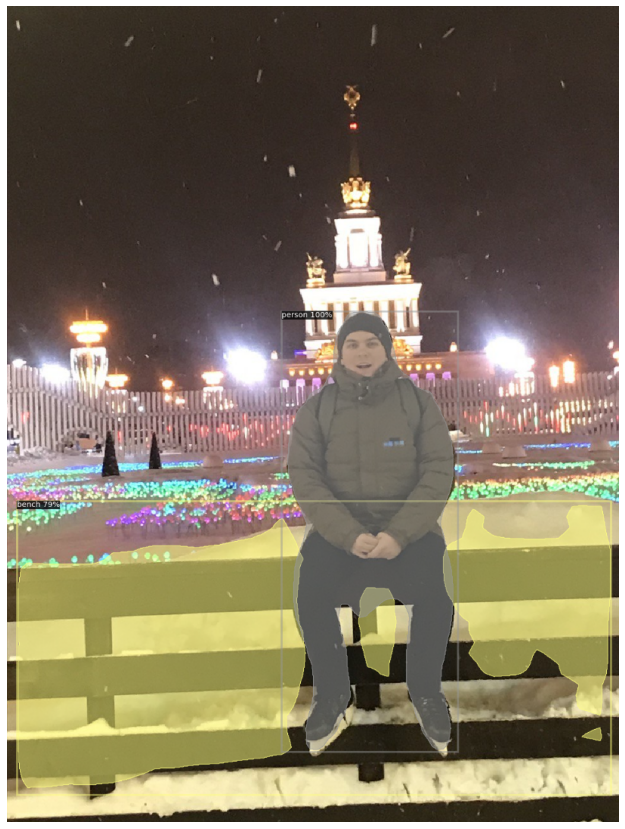

In [ ]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)

for name, image in images.items():
    outputs = predictor(image)
    v = Visualizer(cv2.cvtColor(image, cv2.COLOR_BGR2RGB), MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    resize_and_show(cv2.cvtColor(out.get_image(), cv2.COLOR_RGB2BGR))

### Первая модель: BlazePose by MediaPipe

In [ ]:
with open(PATH + 'data.txt') as f:
    names = f.read().split('\n')[:-1]

images = {name: cv2.imread(PATH + 'images/' + name) for name in names}

In [ ]:
KEYPOINT_DICT = {
    "right ankle": mp_pose.PoseLandmark.RIGHT_ANKLE,
    "right knee": mp_pose.PoseLandmark.RIGHT_KNEE,
    "right hip": mp_pose.PoseLandmark.RIGHT_HIP,
    "left hip": mp_pose.PoseLandmark.LEFT_HIP,
    "left knee": mp_pose.PoseLandmark.LEFT_KNEE,
    "left ankle": mp_pose.PoseLandmark.LEFT_ANKLE,
    "right wrist": mp_pose.PoseLandmark.RIGHT_WRIST,
    "right elbow": mp_pose.PoseLandmark.RIGHT_ELBOW,
    "right shoulder": mp_pose.PoseLandmark.RIGHT_SHOULDER,
    "left shoulder": mp_pose.PoseLandmark.LEFT_SHOULDER,
    "left elbow": mp_pose.PoseLandmark.LEFT_ELBOW,
    "left wrist": mp_pose.PoseLandmark.LEFT_WRIST,
}

In [ ]:
mp_pose = mp.solutions.pose
mp_drawing = mp.solutions.drawing_utils 
mp_drawing_styles = mp.solutions.drawing_styles

# help(mp_pose.Pose)

In [ ]:
results = []

with mp_pose.Pose(static_image_mode=True, min_detection_confidence=0.5, model_complexity=1) as pose:
    for name, image in images.items():
    # Convert the BGR image to RGB and process it with MediaPipe Pose.
        keypoints = pose.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

        image_hight, image_width, _ = image.shape
        if not keypoints.pose_landmarks:
            continue
        coords = []
        for key in KEYPOINTS.keys():
            coords.append([
                     keypoints.pose_landmarks.landmark[KEYPOINT_DICT[key]].x * image_width,
                     keypoints.pose_landmarks.landmark[KEYPOINT_DICT[key]].y * image_height,
                     keypoints.pose_landmarks.landmark[KEYPOINT_DICT[key]].visibility
            ])
        results.append(np.array(coords))

        

In [ ]:
# calculate metrics
pck = {}
pdj = {}
for threshold in [0.05, 0.2, 0.5]:
    pdjs = []
    pcks = []
    for pred, real in zip(results, real_data):
        pdjs.append(calc_pdj(pred, real, threshold))
        pcks.append(calc_pck(pred, real, threshold))
    
    pck[threshold] = round(np.mean(pcks), 3)
    pdj[threshold] = round(np.mean(pdjs), 3)

In [ ]:
print(f"pck: {pck}")
print(f"pdj: {pdj}")

pck: {0.05: 0.027, 0.2: 0.299, 0.5: 0.737}
pdj: {0.05: 0.035, 0.2: 0.355, 0.5: 0.812}


### Вторая модель: Move_Net.Singe_Pose.lightning by TensorFlowHub

In [ ]:
model_name = "movenet_lightning"
module = hub.load("https://tfhub.dev/google/movenet/singlepose/lightning/4")

def movenet(input_image):
    """Runs detection on an input image.

    Args:
        input_image: A [1, height, width, 3] tensor represents the input image
        pixels. Note that the height/width should already be resized and match the
        expected input resolution of the model before passing into this function.

    Returns:
        A [1, 1, 17, 3] float numpy array representing the predicted keypoint
        coordinates and scores.
    """
    model = module.signatures['serving_default']

    # SavedModel format expects tensor type of int32.
    input_image = tf.cast(input_image, dtype=tf.int32)
    # Run model inference.
    outputs = model(input_image)
    # Output is a [1, 1, 17, 3] tensor.
    keypoints_with_scores = outputs['output_0'].numpy()
    return keypoints_with_scores

In [ ]:
KEYPOINT_DICT = {
    'nose': 0,
    'left eye': 1,
    'right eye': 2,
    'left ear': 3,
    'right ear': 4,
    'left shoulder': 5,
    'right shoulder': 6,
    'left elbow': 7,
    'right elbow': 8,
    'left wrist': 9,
    'right wrist': 10,
    'left hip': 11,
    'right hip': 12,
    'left knee': 13,
    'right knee': 14,
    'left ankle': 15,
    'right ankle': 16
}

# Maps bones to a matplotlib color name.
KEYPOINT_EDGE_INDS_TO_COLOR = {
    (0, 1): 'm',
    (0, 2): 'c',
    (1, 3): 'm',
    (2, 4): 'c',
    (0, 5): 'm',
    (0, 6): 'c',
    (5, 7): 'm',
    (7, 9): 'm',
    (6, 8): 'c',
    (8, 10): 'c',
    (5, 6): 'y',
    (5, 11): 'm',
    (6, 12): 'c',
    (11, 12): 'y',
    (11, 13): 'm',
    (13, 15): 'm',
    (12, 14): 'c',
    (14, 16): 'c'
}

def _keypoints_and_edges_for_display(keypoints_with_scores,
                                     height,
                                     width,
                                     keypoint_threshold=0.11):
  """Returns high confidence keypoints and edges for visualization.

  Args:
    keypoints_with_scores: A numpy array with shape [1, 1, 17, 3] representing
      the keypoint coordinates and scores returned from the MoveNet model.
    height: height of the image in pixels.
    width: width of the image in pixels.
    keypoint_threshold: minimum confidence score for a keypoint to be
      visualized.

  Returns:
    A (keypoints_xy, edges_xy, edge_colors) containing:
      * the coordinates of all keypoints of all detected entities;
      * the coordinates of all skeleton edges of all detected entities;
      * the colors in which the edges should be plotted.
  """
  keypoints_all = []
  keypoint_edges_all = []
  edge_colors = []
  num_instances, _, _, _ = keypoints_with_scores.shape
  for idx in range(num_instances):
    kpts_x = keypoints_with_scores[0, idx, :, 1]
    kpts_y = keypoints_with_scores[0, idx, :, 0]
    kpts_scores = keypoints_with_scores[0, idx, :, 2]
    kpts_absolute_xy = np.stack(
        [width * np.array(kpts_x), height * np.array(kpts_y)], axis=-1)
    kpts_above_thresh_absolute = kpts_absolute_xy[
        kpts_scores > keypoint_threshold, :]
    keypoints_all.append(kpts_above_thresh_absolute)

    for edge_pair, color in KEYPOINT_EDGE_INDS_TO_COLOR.items():
      if (kpts_scores[edge_pair[0]] > keypoint_threshold and
          kpts_scores[edge_pair[1]] > keypoint_threshold):
        x_start = kpts_absolute_xy[edge_pair[0], 0]
        y_start = kpts_absolute_xy[edge_pair[0], 1]
        x_end = kpts_absolute_xy[edge_pair[1], 0]
        y_end = kpts_absolute_xy[edge_pair[1], 1]
        line_seg = np.array([[x_start, y_start], [x_end, y_end]])
        keypoint_edges_all.append(line_seg)
        edge_colors.append(color)
  if keypoints_all:
    keypoints_xy = np.concatenate(keypoints_all, axis=0)
  else:
    keypoints_xy = np.zeros((0, 17, 2))

  if keypoint_edges_all:
    edges_xy = np.stack(keypoint_edges_all, axis=0)
  else:
    edges_xy = np.zeros((0, 2, 2))
  return keypoints_xy, edges_xy, edge_colors


def draw_prediction_on_image(
    image, keypoints_with_scores, crop_region=None, close_figure=False,
    output_image_height=None):
  """Draws the keypoint predictions on image.

  Args:
    image: A numpy array with shape [height, width, channel] representing the
      pixel values of the input image.
    keypoints_with_scores: A numpy array with shape [1, 1, 17, 3] representing
      the keypoint coordinates and scores returned from the MoveNet model.
    crop_region: A dictionary that defines the coordinates of the bounding box
      of the crop region in normalized coordinates (see the init_crop_region
      function below for more detail). If provided, this function will also
      draw the bounding box on the image.
    output_image_height: An integer indicating the height of the output image.
      Note that the image aspect ratio will be the same as the input image.

  Returns:
    A numpy array with shape [out_height, out_width, channel] representing the
    image overlaid with keypoint predictions.
  """
  height, width, channel = image.shape
  aspect_ratio = float(width) / height
  fig, ax = plt.subplots(figsize=(12 * aspect_ratio, 12))
  # To remove the huge white borders
  fig.tight_layout(pad=0)
  ax.margins(0)
  ax.set_yticklabels([])
  ax.set_xticklabels([])
  plt.axis('off')

  im = ax.imshow(image)
  line_segments = LineCollection([], linewidths=(4), linestyle='solid')
  ax.add_collection(line_segments)
  # Turn off tick labels
  scat = ax.scatter([], [], s=60, color='#FF1493', zorder=3)

  (keypoint_locs, keypoint_edges,
   edge_colors) = _keypoints_and_edges_for_display(
       keypoints_with_scores, height, width)

  line_segments.set_segments(keypoint_edges)
  line_segments.set_color(edge_colors)
  if keypoint_edges.shape[0]:
    line_segments.set_segments(keypoint_edges)
    line_segments.set_color(edge_colors)
  if keypoint_locs.shape[0]:
    scat.set_offsets(keypoint_locs)

  if crop_region is not None:
    xmin = max(crop_region['x_min'] * width, 0.0)
    ymin = max(crop_region['y_min'] * height, 0.0)
    rec_width = min(crop_region['x_max'], 0.99) * width - xmin
    rec_height = min(crop_region['y_max'], 0.99) * height - ymin
    rect = patches.Rectangle(
        (xmin,ymin),rec_width,rec_height,
        linewidth=1,edgecolor='b',facecolor='none')
    ax.add_patch(rect)

  fig.canvas.draw()
  image_from_plot = np.frombuffer(fig.canvas.tostring_rgb(), dtype=np.uint8)
  image_from_plot = image_from_plot.reshape(
      fig.canvas.get_width_height()[::-1] + (3,))
  plt.close(fig)
  if output_image_height is not None:
    output_image_width = int(output_image_height / height * width)
    image_from_plot = cv2.resize(
        image_from_plot, dsize=(output_image_width, output_image_height),
         interpolation=cv2.INTER_CUBIC)
  return image_from_plot


In [ ]:
# read data
with open(PATH + 'data.txt') as f:
    names = f.read().split('\n')[:-1]
images = {name: tf.image.decode_jpeg(tf.io.read_file(PATH + "images/" + name)) for name in names}

In [ ]:
input_size = 192
results = []

for name, image in images.items():
    # Resize and pad the image to keep the aspect ratio and fit the expected size.
    input_image = tf.expand_dims(image, axis=0)
    input_image = tf.image.resize_with_pad(input_image, input_size, input_size)
    image_height, image_width, _ = image.shape

    # Run model inference.
    keypoints_with_scores = movenet(input_image)

    coords = []
    for key in KEYPOINTS.keys():
        coord = keypoints_with_scores[0,0,KEYPOINT_DICT[key]] * [image_height, image_width, 1]
        coords.append([coord[1], coord[0], coord[2]])
    results.append(np.array(coords))

In [ ]:
# calculate metrics
pck = {}
pdj = {}
for threshold in [0.05, 0.2, 0.5]:
    pdjs = []
    pcks = []
    for pred, real in zip(results, real_data):
        pdjs.append(calc_pdj(pred, real, threshold))
        pcks.append(calc_pck(pred, real, threshold))
    
    pck[threshold] = round(np.mean(pcks), 3)
    pdj[threshold] = round(np.mean(pdjs), 3)

In [ ]:
print(f"pck: {pck}")
print(f"pdj: {pdj}")

pck: {0.05: 0.356, 0.2: 0.928, 0.5: 0.983}
pdj: {0.05: 0.43, 0.2: 0.95, 0.5: 0.993}


### Третья модель: OpenPose

In [ ]:
from os.path import exists, join, basename, splitext

git_repo_url = 'https://github.com/CMU-Perceptual-Computing-Lab/openpose.git'
project_name = splitext(basename(git_repo_url))[0]
if not exists(project_name):
  # see: https://github.com/CMU-Perceptual-Computing-Lab/openpose/issues/949
  # install new CMake becaue of CUDA10
  !wget -q https://cmake.org/files/v3.13/cmake-3.13.0-Linux-x86_64.tar.gz
  !tar xfz cmake-3.13.0-Linux-x86_64.tar.gz --strip-components=1 -C /usr/local
  # clone openpose
  !git clone -q --depth 1 $git_repo_url
  !sed -i 's/execute_process(COMMAND git checkout master WORKING_DIRECTORY ${CMAKE_SOURCE_DIR}\/3rdparty\/caffe)/execute_process(COMMAND git checkout f019d0dfe86f49d1140961f8c7dec22130c83154 WORKING_DIRECTORY ${CMAKE_SOURCE_DIR}\/3rdparty\/caffe)/g' openpose/CMakeLists.txt
  # install system dependencies
  !apt-get -qq install -y libatlas-base-dev 
  !apt-get -qq install -y libprotobuf-dev 
  !apt-get -qq install -y libleveldb-dev 
  !apt-get -qq install -y libsnappy-dev
  !apt-get -qq install -y libhdf5-serial-dev
  !apt-get -qq install -y protobuf-compiler
  !apt-get -qq install -y libgflags-dev
  !apt-get -qq install -y libgoogle-glog-dev
  # build openpose
  !cd openpose && rm -rf build || true && mkdir build && cd build && cmake -DBUILD_PYTHON=ON .. && make -j`nproc`
if not exists("openpose/images"):
    !mkdir openpose/images
%cd openpose

Selecting previously unselected package libprotobuf-lite10:amd64.
(Reading database ... 155629 files and directories currently installed.)
Preparing to unpack .../libprotobuf-lite10_3.0.0-9.1ubuntu1_amd64.deb ...
Unpacking libprotobuf-lite10:amd64 (3.0.0-9.1ubuntu1) ...
Selecting previously unselected package libprotobuf-dev:amd64.
Preparing to unpack .../libprotobuf-dev_3.0.0-9.1ubuntu1_amd64.deb ...
Unpacking libprotobuf-dev:amd64 (3.0.0-9.1ubuntu1) ...
Setting up libprotobuf-lite10:amd64 (3.0.0-9.1ubuntu1) ...
Setting up libprotobuf-dev:amd64 (3.0.0-9.1ubuntu1) ...
Processing triggers for libc-bin (2.27-3ubuntu1.3) ...
/sbin/ldconfig.real: /usr/local/lib/python3.7/dist-packages/ideep4py/lib/libmkldnn.so.0 is not a symbolic link

Selecting previously unselected package libleveldb1v5:amd64.
(Reading database ... 155750 files and directories currently installed.)
Preparing to unpack .../libleveldb1v5_1.20-2_amd64.deb ...
Unpacking libleveldb1v5:amd64 (1.20-2) ...
Selecting previously u

In [ ]:
# Define directories path
OpenposeDir = '/content/openpose/'

images_list = []
for name in names:
    src = os.path.join(PATH, 'images', name)
    destination = os.path.join(OpenposeDir,'images',name)
    shutil.copy(src, destination)
    images_list.append(destination)

images_list

In [ ]:
KEYPOINT_DICT = {
    "right ankle": 11,
    "right knee": 10,
    "right hip": 9,
    "left hip": 12,
    "left knee": 13,
    "left ankle": 14,
    "right wrist": 4,
    "right elbow": 3,
    "right shoulder": 2,
    "left shoulder": 5,
    "left elbow": 6,
    "left wrist": 7,
}

In [ ]:
# Import general libraries
warnings.simplefilter(action='ignore', category=FutureWarning)

# Set Python Openpose Directory for python api (Important)
pyopenpose_dir = os.path.join(OpenposeDir,'build','python') # ex: '/content/openpose/build/python'
if pyopenpose_dir not in sys.path:
    sys.path.append(pyopenpose_dir)
from openpose import pyopenpose as op

# Custom Params (refer to openpose/include/openpose/flags.hpp for more parameters)
params = dict()
params["model_folder"] = os.path.join(OpenposeDir,'models')  # ex: '/content/openpose/models'

# Starting OpenPose
opWrapper = op.WrapperPython()
opWrapper.configure(params)
opWrapper.start()

results = []
# Process Image
for i, image in enumerate(images_list):
    datum = op.Datum()
    input_image = cv2.imread(image) # Change Image Here
    datum.cvInputData = input_image
    opWrapper.emplaceAndPop(op.VectorDatum([datum]))
    network_output = datum.poseKeypoints

    coords = []
    if not network_output is None:
        for key in KEYPOINTS.keys():
            sec_index = KEYPOINT_DICT[key]
            coords.append(network_output[0, sec_index])
    else:
        coords = np.zeros((14,3), dtype=np.float32)
    results.append(np.array(coords))

In [ ]:
# calculate metrics
pck = {}
pdj = {}
for threshold in [0.05, 0.2, 0.5]:
    pdjs = []
    pcks = []
    for pred, real in zip(results, real_data):
        pdjs.append(calc_pdj(pred, real, threshold))
        pcks.append(calc_pck(pred, real, threshold))
    
    pck[threshold] = round(np.mean(pcks), 3)
    pdj[threshold] = round(np.mean(pdjs), 3)

In [ ]:
print(f"pck: {pck}")
print(f"pdj: {pdj}")

pck: {0.05: 0.708, 0.2: 0.837, 0.5: 0.882}
pdj: {0.05: 0.746, 0.2: 0.845, 0.5: 0.899}


### Четвертая модель: MMPose by Open-MMLab

In [7]:
# check NVCC version
!nvcc -V

# check GCC version
!gcc --version

# check python in conda environment
!which python

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Mon_Oct_12_20:09:46_PDT_2020
Cuda compilation tools, release 11.1, V11.1.105
Build cuda_11.1.TC455_06.29190527_0
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.

/usr/local/bin/python


In [9]:
# install dependencies: (use cu111 because colab has CUDA 11.1)
%pip install torch==1.10.0+cu111 torchvision==0.11.0+cu111 -f https://download.pytorch.org/whl/torch_stable.html

# install mmcv-full thus we could use CUDA operators
%pip install mmcv-full -f https://download.openmmlab.com/mmcv/dist/cu111/torch1.10.0/index.html

# install mmdet for inference demo
%pip install mmdet

# clone mmpose repo
%rm -rf mmpose
!git clone https://github.com/open-mmlab/mmpose.git
%cd mmpose

# install mmpose dependencies
%pip install -r requirements.txt

# install mmpose in develop mode
%pip install -e .

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████▌                   | 834.1 MB 1.4 MB/s eta 0:15:18tcmalloc: large alloc 1147494400 bytes == 0x3a1b6000 @  0x7f5723e74615 0x592b76 0x4df71e 0x59afff 0x515655 0x549576 0x593fce 0x548ae9 0x51566f 0x549576 0x593fce 0x548ae9 0x5127f1 0x598e3b 0x511f68 0x598e3b 0x511f68 0x598e3b 0x511f68 0x4bc98a 0x532e76 0x594b72 0x515600 0x549576 0x593fce 0x548ae9 0x5127f1 0x549576 0x593fce 0x5118f8 0x593dd7
     |███████████████▉                | 1055.7 MB 1.2 MB/s eta 0:14:48tcmalloc: large alloc 1434370048 bytes == 0x7e80c000 @  0x7f5723e74615 0x592b76 0x4df71e 0x59afff 0x515655 0x549576 0x593fce 0x548ae9 0x51566f 0x549576 0x593fce 0x548ae9 0x5127f1 0x598e3b 0x511f68 0x598e3b 0x511f68 0x598e3b 0x511f68 0x4bc98a 0x532e76 0x594b72 0x515600 0x549576 0x593fce 0x548ae9 0x5127f1 0x549576 0x593fce 0x5118f8 0x593dd7
     |█████

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.openmmlab.com/mmcv/dist/cu111/torch1.10.0/index.html
     |████████████████████████████████| 46.4 MB 7.3 MB/s 
     |████████████████████████████████| 190 kB 25.6 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.4 MB 27.9 MB/s 
Cloning into 'mmpose'...
remote: Enumerating objects: 19204, done.
remote: Counting objects: 100% (1159/1159), done.
remote: Compressing objects: 100% (568/568), done.
remote: Total 19204 (delta 696), reused 907 (delta 573), pack-reused 18045
Receiving objects: 100% (19204/19204), 24.91 MiB | 40.55 MiB/s, done.
Resolving deltas: 100% (13457/13457), done.
/content/mmpose
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Ignoring dataclasses: markers 'python_version == "3.6"' don't match 

In [10]:
# Check Pytorch installation
import torch, torchvision

print('torch version:', torch.__version__, torch.cuda.is_available())
print('torchvision version:', torchvision.__version__)

# Check MMPose installation
import mmpose

print('mmpose version:', mmpose.__version__)

# Check mmcv installation
from mmcv.ops import get_compiling_cuda_version, get_compiler_version

print('cuda version:', get_compiling_cuda_version())
print('compiler information:', get_compiler_version())

torch version: 1.11.0+cu113 True
torchvision version: 0.12.0+cu113
mmpose version: 0.26.0
cuda version: 11.1
compiler information: GCC 7.3


In [11]:
from mmpose.apis import (inference_top_down_pose_model, init_pose_model,
                         vis_pose_result, process_mmdet_results)
from mmdet.apis import inference_detector, init_detector

pose_config = 'configs/body/2d_kpt_sview_rgb_img/topdown_heatmap/coco/hrnet_w48_coco_256x192.py'
pose_checkpoint = 'https://download.openmmlab.com/mmpose/top_down/hrnet/hrnet_w48_coco_256x192-b9e0b3ab_20200708.pth'
det_config = 'demo/mmdetection_cfg/faster_rcnn_r50_fpn_coco.py'
det_checkpoint = 'https://download.openmmlab.com/mmdetection/v2.0/faster_rcnn/faster_rcnn_r50_fpn_1x_coco/faster_rcnn_r50_fpn_1x_coco_20200130-047c8118.pth'

# initialize pose model
pose_model = init_pose_model(pose_config, pose_checkpoint)
# initialize detector
det_model = init_detector(det_config, det_checkpoint)

load checkpoint from http path: https://download.openmmlab.com/mmpose/top_down/hrnet/hrnet_w48_coco_256x192-b9e0b3ab_20200708.pth


Downloading: "https://download.openmmlab.com/mmpose/top_down/hrnet/hrnet_w48_coco_256x192-b9e0b3ab_20200708.pth" to /root/.cache/torch/hub/checkpoints/hrnet_w48_coco_256x192-b9e0b3ab_20200708.pth


  0%|          | 0.00/243M [00:00<?, ?B/s]

load checkpoint from http path: https://download.openmmlab.com/mmdetection/v2.0/faster_rcnn/faster_rcnn_r50_fpn_1x_coco/faster_rcnn_r50_fpn_1x_coco_20200130-047c8118.pth


Downloading: "https://download.openmmlab.com/mmdetection/v2.0/faster_rcnn/faster_rcnn_r50_fpn_1x_coco/faster_rcnn_r50_fpn_1x_coco_20200130-047c8118.pth" to /root/.cache/torch/hub/checkpoints/faster_rcnn_r50_fpn_1x_coco_20200130-047c8118.pth


  0%|          | 0.00/160M [00:00<?, ?B/s]

In [16]:
KEYPOINT_DICT = {
    "right ankle": 16,
    "right knee": 14,
    "right hip": 12,
    "left hip": 11,
    "left knee": 13,
    "left ankle": 15,
    "right wrist": 10,
    "right elbow": 8,
    "right shoulder": 6,
    "left shoulder": 5,
    "left elbow": 7,
    "left wrist": 9,
}

# "keypoints": [
#             "nose","left_eye","right_eye","left_ear","right_ear",
#             "left_shoulder","right_shoulder","left_elbow","right_elbow",
#             "left_wrist","right_wrist","left_hip","right_hip",
#             "left_knee","right_knee","left_ankle","right_ankle"
#         ]

In [26]:
with open(PATH + 'data.txt') as f:
    names = f.read().split('\n')[:-1]

results = []
for name in names:
    name = PATH + 'images/' + name
    # inference detection
    mmdet_results = inference_detector(det_model, name)

    # extract person (COCO_ID=1) bounding boxes from the detection results
    person_results = process_mmdet_results(mmdet_results, cat_id=1)

    # inference pose
    pose_results, returned_outputs = inference_top_down_pose_model(
        pose_model,
        name,
        person_results,
        bbox_thr=0.3,
        format='xyxy',
        dataset=pose_model.cfg.data.test.type)
    
    if pose_results:
        pose_results = pose_results[0]['keypoints']
    else:
        pose_results = np.zeros((17,3))

    coords = []
    for key in KEYPOINTS.keys():
        coords.append(pose_results[KEYPOINT_DICT[key]])
    results.append(np.array(coords))

In [ ]:
min(pose_results[0]['keypoints'][:, 0])

463.9202

In [ ]:
pose_results

[{'bbox': array([4.1509595e+02, 4.7435385e+02, 7.1153528e+02, 1.1762910e+03,
         9.9949813e-01], dtype=float32),
  'keypoints': array([[5.5988818e+02, 5.4770081e+02, 9.3073452e-01],
         [5.7359790e+02, 5.2713623e+02, 9.4274658e-01],
         [5.3932361e+02, 5.3399109e+02, 9.1980088e-01],
         [5.9416248e+02, 5.4084595e+02, 9.1938812e-01],
         [5.2561389e+02, 5.4770081e+02, 9.2316383e-01],
         [6.4214636e+02, 6.2310425e+02, 9.0067244e-01],
         [4.9133963e+02, 6.2995898e+02, 8.9948386e-01],
         [6.7642065e+02, 7.3278186e+02, 8.9461672e-01],
         [4.6392020e+02, 7.3278186e+02, 9.0676326e-01],
         [6.1472705e+02, 8.2189502e+02, 9.2593825e-01],
         [5.3246875e+02, 8.2874988e+02, 9.2971933e-01],
         [6.3529163e+02, 8.2874988e+02, 8.2808340e-01],
         [5.2561389e+02, 8.2874988e+02, 8.1915498e-01],
         [6.7642065e+02, 9.1786304e+02, 8.4691548e-01],
         [4.7077505e+02, 9.1786304e+02, 8.9652777e-01],
         [6.5585608e+02, 1.06

In [27]:
# calculate metrics
pck = {}
pdj = {}
for threshold in [0.05, 0.2, 0.5]:
    pdjs = []
    pcks = []
    for pred, real in zip(results, real_data):
        pdjs.append(calc_pdj(pred, real, threshold))
        pcks.append(calc_pck(pred, real, threshold))
    
    pck[threshold] = round(np.mean(pcks), 3)
    pdj[threshold] = round(np.mean(pdjs), 3)

In [28]:
print(f"pck: {pck}")
print(f"pdj: {pdj}")

pck: {0.05: 0.728, 0.2: 0.85, 0.5: 0.914}
pdj: {0.05: 0.76, 0.2: 0.858, 0.5: 0.933}


## Вторая часть работы: Pose Classification

# Выводы